# Unpacking Instacart: A Deep Dive into North American Grocery E-Commerce Behavior

## Setup & Context

### Introduction

**Instacart** is the leading grocery technology company in North America, partnering with more than 1,400 national, regional, and local retail banners to deliver from more than 80,000 stores across more than 14,000 cities in North America.
![Instacart mobile app screens](Instacart.png)

The primary objective of the project is to delve into the Instacart sales data and craft every conceivable insight that can contribute to the further business growth.

**Main questions to answer:**
- What shopper behaviour is at different hours of the day? days of the week?
- How often and when are products from different department/aisle sold?
- How many days pass before people place another order?
- How many items do people buy?
- Which items are the best sellers?
- Which items are most frequently reordered?
- Which items are added to the cart first? second? third?

### Import Statements

In [1]:
import pymysql
import json

import pandas as pd

import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import seaborn as sns
import squarify

import numpy as np

from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.cluster import KMeans

### Notebook Representation

In [2]:
pd.options.display.float_format = '{:,.2f}'.format

### Connecting Jupyter Notebook to a MySQL database

In [3]:
# Load credentials from the JSON file
with open("credentials.json", "r") as file:
    creds = json.load(file)

# Connection parameters
host_name = creds["host_name"]
user_name = creds["user_name"]
user_password = creds["user_password"]
database_name = creds["database_name"]

# Establishing the connection
connection = pymysql.connect(
    host=host_name,
    user=user_name,
    password=user_password,
    db=database_name
)

# Check if you're connected
if connection.open:
    print("Connected to the database")
else:
    print("Failed to connect")

Connected to the database


### Reading data into DataFrame

In [4]:
## Read data from SQL

# Aisles
query_aisles = "SELECT * FROM aisles;"
df_aisles = pd.read_sql(query_aisles, connection)

# Departments
query_departments = "SELECT * FROM departments;"
df_departments = pd.read_sql(query_departments, connection)

# Products
query_products = "SELECT * FROM products;"
df_products = pd.read_sql(query_products, connection)

/var/folders/cg/n7htz_ln3zj5mmzz67myjyzc0000gn/T/ipykernel_1353/1331172361.py:5: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_aisles = pd.read_sql(query_aisles, connection)
/var/folders/cg/n7htz_ln3zj5mmzz67myjyzc0000gn/T/ipykernel_1353/1331172361.py:9: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_departments = pd.read_sql(query_departments, connection)
/var/folders/cg/n7htz_ln3zj5mmzz67myjyzc0000gn/T/ipykernel_1353/1331172361.py:13: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_products = pd.read_sql(query_produ

In order to expedite the data analysis process, the data from other datasets will be retrieved from CSV files directly.

In [5]:
## Read data from .csv files

# Orders
df_orders = pd.read_csv('data/orders.csv')

# Orders_prior
df_orders_prior = pd.read_csv('data/order_products__prior.csv')

# Orders_train
df_orders_train = pd.read_csv('data/order_products__train.csv')

### Setting up main DataFrames for further processing

In [6]:
# Product map
prods_df = df_products.merge(df_departments[['department_id', 'department']],
                             on='department_id',
                             how='left',
                            )
prods_df = prods_df.merge(df_aisles[['aisle_id', 'aisle']],
                          on='aisle_id',
                          how='left',
                         )
prods_df.head(3)

,product_id,product_name,aisle_id,department_id,department,aisle
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes
1,2,All-Seasons Salt,104,13,pantry,spices seasonings
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea


In [91]:
# Orders with products
prior_train_orders = pd.concat([df_orders_prior, df_orders_train], ignore_index=True)
orders_products_df = pd.merge(prior_train_orders, prods_df, on='product_id')
orders_products_df.head(3)

,order_id,product_id,add_to_cart_order,reordered,product_name,aisle_id,department_id,department,aisle
0,2,33120,1,1,Organic Egg Whites,86,16,dairy eggs,eggs
1,26,33120,5,0,Organic Egg Whites,86,16,dairy eggs,eggs
2,120,33120,13,0,Organic Egg Whites,86,16,dairy eggs,eggs


In [93]:
# Fully merged DataFrame
merged_df = pd.merge(orders_products_df, df_orders, on='order_id')
merged_df.head()

,order_id,product_id,add_to_cart_order,reordered,product_name,aisle_id,department_id,department,aisle,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2,33120,1,1,Organic Egg Whites,86,16,dairy eggs,eggs,202279,prior,3,5,9,8.00
1,2,28985,2,1,Michigan Organic Kale,83,4,produce,fresh vegetables,202279,prior,3,5,9,8.00
2,2,9327,3,0,Garlic Powder,104,13,pantry,spices seasonings,202279,prior,3,5,9,8.00
3,2,45918,4,1,Coconut Butter,19,13,pantry,oils vinegars,202279,prior,3,5,9,8.00
4,2,30035,5,0,Natural Sweetener,17,13,pantry,baking ingredients,202279,prior,3,5,9,8.00


## I. Preliminary Data Exploration Analysis

Preliminary data exploration analysis has been conducted in a separate Jupyter notebook titled `'Instacart-prelim-data-exploration'`.

##### Key Conclusions
* The dataset is a relational set of 7 files describing customers' orders over time.
    * `orders.csv` is the central file with an information about all orders made on the platform, but without product specifics.
        * Note: Memory usage of this file is nearly 1GB; consider this when merging with other data frames.
    * `order_products__prior.csv` and `order_products__train.csv` specifies which products were purchased in each order.
    * `sample_submission.csv` contains test data (order IDs only) reserved for machine learning competitions and identifies the last order for 75,000 users. Thus, for further data analysis purporses this file will be **out of scope**.
    * `order_products__train.csv` and `sample_submission.csv` (test) identify the last order for every user.
    * `departments.csv`, `aisles.csv` and `products.csv` contain product related information only.
* Data cleaning is not needed.

##### Dataset Dimensions Overview
* The dataset is anonymized and contains a sample of **over 3 million (3,421,083) grocery orders** from more than **200,000 (206,209) Instacart users**.
* Initial orders constitute 6.4% of the total orders.
* For each user, provided **between 4 and 100 of their orders**, with the sequence of products purchased in each order.
* There are **49,688 products** available on the platform. They are organized into **134 aisles** and **21 departments**.

## II. Data Cleaning
In accordance with the data exploration results, there is no need in data cleaning.

## III. Data Analytics

### How many items were sold on the platform?

In [15]:
orders_products_df.shape

(33819106, 9)

Users bought around **34 million products** on the platform.

**Note:** As was mentioned above, 75,000 orders from the test evaluation set are not taken into account. There is no data about the products that were ordered in these orders. Thus, sales might be over 34 million products.

### How many orders are made at different hours of the day?

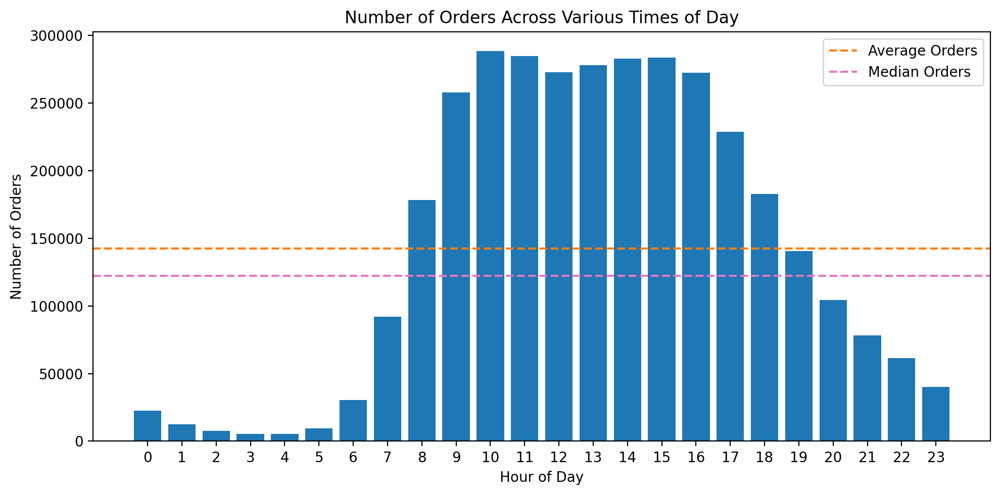

In [7]:
orders_per_hour = df_orders.order_hour_of_day.value_counts()

# Sorting the index to have a sequential x-axis
orders_per_hour = orders_per_hour.sort_index()

# Calculate the average and median
avg_orders = orders_per_hour.values.mean()
median_orders = np.median(orders_per_hour.values)

# Creating the bar chart
plt.figure(figsize=(10, 5), dpi=200)
plt.bar(orders_per_hour.index,
        orders_per_hour.values,
       )

# Adding the average and median lines
plt.axhline(avg_orders, color='tab:orange', linestyle='--', label='Average Orders')
plt.axhline(median_orders, color='tab:pink', linestyle='--', label='Median Orders')

# Adding titles and labels
plt.title('Number of Orders Across Various Times of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Orders')
plt.xticks(list(range(24)))  # Ensure all hours are shown on the x-axis
plt.legend()

# Display the chart
plt.tight_layout()
plt.show()

The majority of orders are placed between 8:00 and 19:00, with the highest volume occurring **between 10:00 and 16:00**. However, there isn't a distinct rush hour. It's natural for grocery orders to be made during the day.

### How many orders are made at different days of the week?

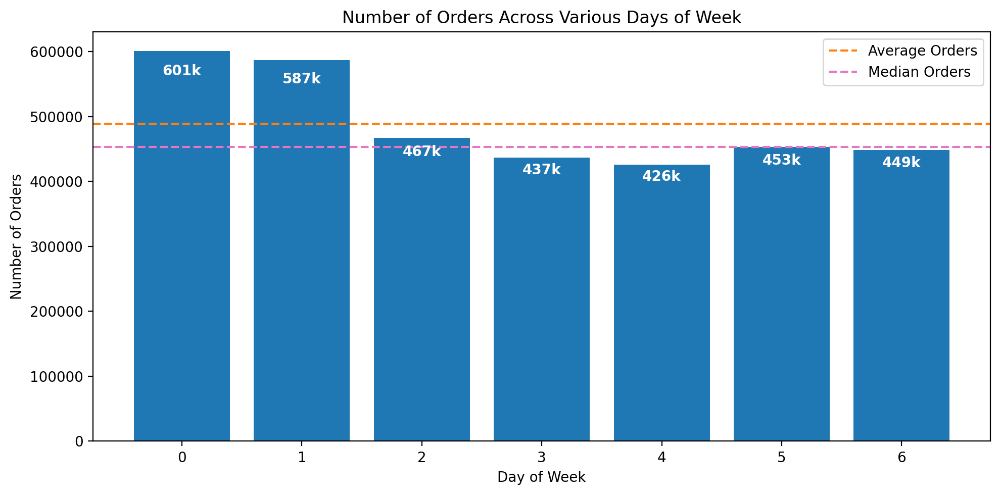

In [8]:
orders_per_day = df_orders.order_dow.value_counts()

# Sorting the index to have a sequential x-axis
orders_per_day = orders_per_day.sort_index()

# Calculate the average and median
avg_orders_day = orders_per_day.values.mean()
median_orders_day = np.median(orders_per_day.values)

# Function to format the values
def format_value(value):
    return "{:.0f}k".format(value/1000) if value >= 1000 else str(value)

# Creating the bar chart
plt.figure(figsize=(10, 5), dpi=200)
bars = plt.bar(orders_per_day.index,
               orders_per_day.values,
              )

# Adding the average and median lines
plt.axhline(avg_orders_day, color='tab:orange', linestyle='--', label='Average Orders')
plt.axhline(median_orders_day, color='tab:pink', linestyle='--', label='Median Orders')

# Displaying the value of each bar inside the bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval - 0.07 * yval, format_value(yval), ha='center', va='bottom', color='white', fontweight='bold')

# Adding titles and labels
plt.title('Number of Orders Across Various Days of Week')
plt.xlabel('Day of Week')
plt.ylabel('Number of Orders')
plt.xticks(list(range(7)))  # Ensure all hours are shown on the x-axis
plt.legend()

# Display the chart
plt.tight_layout()
plt.show()

**Days 0 and 1** are the most popular days for shopping by users.

### What is an hourly trend by each day of the week?

In [9]:
day_hour = df_orders.groupby(['order_dow', 'order_hour_of_day']).order_id.count().reset_index()
day_hour = day_hour.rename(columns={'order_id': 'number_of_orders'})

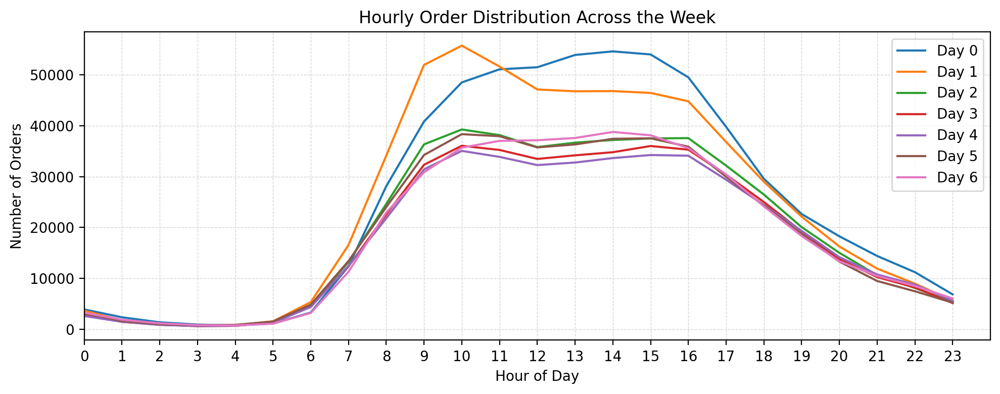

In [10]:
plt.figure(figsize=(10, 4), dpi=200)

for day in range(7):
    subset = day_hour[day_hour['order_dow'] == day]
    plt.plot(subset['order_hour_of_day'], subset['number_of_orders'], label=f'Day {day}')

plt.title('Hourly Order Distribution Across the Week')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Orders')
plt.legend()
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='lightgrey')
plt.xticks(list(range(24)))
plt.xlim(0, 24)
plt.tight_layout()
plt.show()

Key observations:
* **On days 0 and 1**, contrasting trends emerge. On day 1, orders predominantly occur in the morning, between 8:00 and 12:00. In contrast, on day 0, most orders are placed in the afternoon, specifically from 12:00 to 16:00.
* **Day 6** has similar trend with day 0, however the number of orders are much lower.
* The hourly trends for **the rest of the week** follow a similar pattern: there's a peak from 8:00 to 11:00, a decline between 11:00 and 13:00, followed by a slight uptick at 16:00. After 16:00, the number of orders starts to decrease.

In accordance with the observations above:
* Looks like day 0 is Sunday, day 1 is Monday, ..., day 6 is Saturday:
    * Users **order from Sunday afternoon till Monday afternoon more actively compared to the rest of week**. Such a behavour might be explained by the desire to stock up on groceries after the weekend.
    * This also corresponds with the fact that a week in the US starts from Sunday.
* **Saturday (6)** exhibits a trend similar to Sunday (0), but with a significantly lower number of orders. People may engage in housekeeping, rest, or outdoor activities on Saturdays, leading to reduced shopping. 
* **From Tuesday (2) to Friday (5)**, order volumes remain relatively stable from 9:00 to 16:00, with a slight dip around lunchtime, likely due to people taking lunch breaks and having less time to place orders.

### How many items do people usually buy?

In [17]:
products_in_order.describe()

,products_count
count,"3,346,083.00"
mean,10.11
std,7.54
min,1.00
25%,5.00
50%,8.00
75%,14.00
max,145.00


* On average (median) people buy **8 products per order**.
* They buy at least 1 product, and maximum 145 products.
* 75% of the orders has less than 14 products per order. This means the order with 145 products might be an outlier.

In [103]:
# Calculating the number of products per order
products_in_order = orders_products_df.groupby('order_id').agg({'product_id': pd.Series.count})
products_in_order.rename(columns={'product_id':'products_count'}, inplace=True)

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



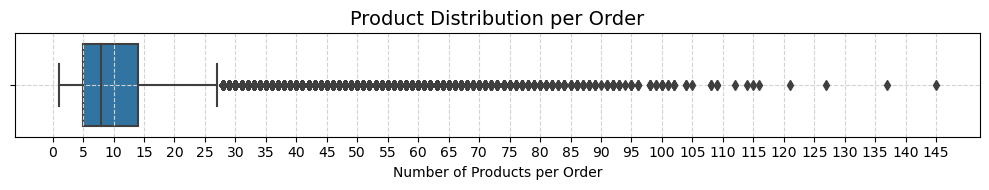

In [138]:
plt.figure(figsize=(10,2))
sns.boxplot(data=products_in_order, x='products_count')
plt.title('Product Distribution per Order', fontsize=14)
plt.xlabel('Number of Products per Order', fontsize=10)
plt.xticks(np.arange(0, products_in_order['products_count'].max()+5, step=5))
plt.grid(True, color='lightgrey', linestyle='--')
plt.tight_layout()

plt.show()

* The median is closer to the bottom of the box and the whisker is shorter on the lower end of the box: the distribution is **positively skewed** (skewed right). In hypothesis testing, correcting for skewness is essential.
* The maximum score, when outliers are excluded, is 27 products per order. This means **27 is the maximum number** of products in a typical order.
* Atypical orders consist of 28 to 145 products per order.

In [131]:
# Estimating outliers
outliers_count = int(products_in_order[products_in_order.products_count > 27].count().iloc[0])
print(f'Outliers count: {outliers_count}')
print(f'Percentage from total: {outliers_count / products_in_order.products_count.count() * 100 :.2}%')

Outliers count: 110280
Percentage from total: 3.3%


Outliers can significantly influence statistical analyses, potentially skewing the outcomes of hypothesis tests. Therefore, when conducting hypothesis testing, it's advisable to remove outliers to promote a more normal distribution.

In this instance, 3.3% of all orders are deemed outliers. Since hypothesis testing is not the objective of our current data analysis, there's no necessity to remove these outliers.

### After how many days do people order again?

In [11]:
df_orders.days_since_prior_order.describe()

count   3,214,874.00
mean           11.11
std             9.21
min             0.00
25%             4.00
50%             7.00
75%            15.00
max            30.00
Name: days_since_prior_order, dtype: float64

* On average (median) people order again **in 7 days (once per week)** and maximum after 30 days from the last order.
* The minimum value is 0 (indicating NaN values), signifying an absence of previous order history. The value subsequent to 0 would provide a more accurate representation of the minimum interval before ordering again.

In [12]:
# Finding the minimum days before ordering again
df_orders[df_orders.days_since_prior_order > 0].sort_values(by='days_since_prior_order', ascending=True)[:3]

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
1218616,2322872,73266,prior,6,6,20,1.00
2156453,78576,129712,prior,37,2,9,1.00
330278,1511763,20001,prior,90,5,12,1.00


Thus, part of users needs **minimum 1 day to reorder**. 

### How many items people buy since a previous order?

In [63]:
# Calculate the number of products per order
products_per_order = merged_df.groupby('order_id')['product_name'].count().reset_index(name='num_products')

# Merge this information back to the original dataframe
df_merged = merged_df.merge(products_per_order, on='order_id')

# Calculate the average number of products per days_since_prior_order value
avg_products = df_merged.groupby('days_since_prior_order')['num_products'].mean().reset_index()
median_products = df_merged.groupby('days_since_prior_order')['num_products'].median().reset_index()
min_products = df_merged.groupby('days_since_prior_order')['num_products'].min().reset_index()
max_products = df_merged.groupby('days_since_prior_order')['num_products'].max().reset_index()

In [94]:
prods_in_order = merged_df.groupby(['order_id', 'days_since_prior_order']).size().reset_index(name='num_products')
prods_in_order.head(3)

,order_id,days_since_prior_order,num_products
0,1,9.00,8
1,2,8.00,9
2,3,12.00,8


/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



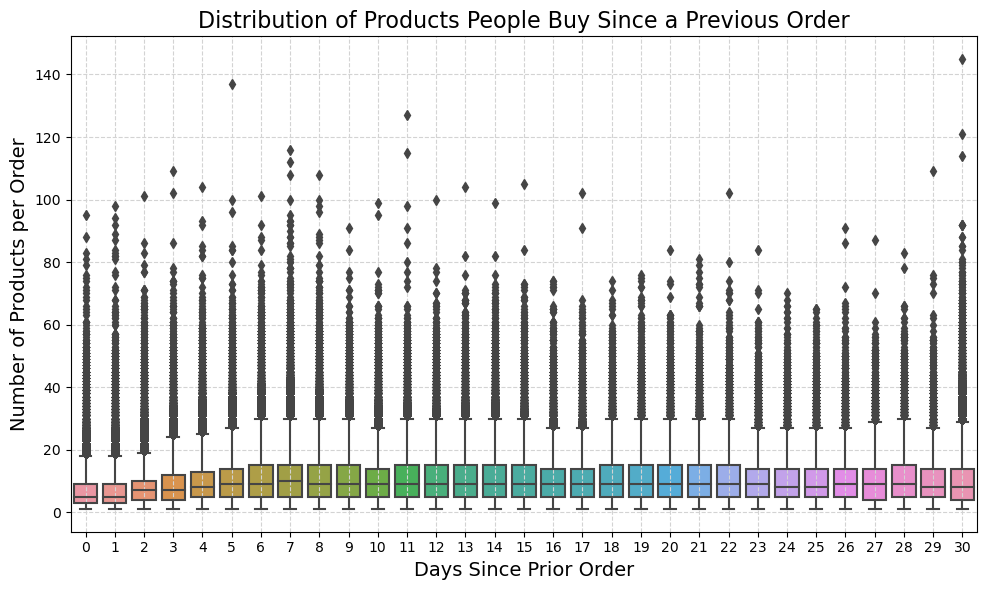

In [152]:
plt.figure(figsize=(10,6))
sns.boxplot(data=prods_in_order, x='days_since_prior_order', y='num_products')
plt.xlabel('Days Since Prior Order', fontsize=14)
plt.ylabel('Number of Products per Order', fontsize=14)
plt.title('Distribution of Products People Buy Since a Previous Order', fontsize=16)
plt.grid(True, color='lightgrey', linestyle='--')
plt.tight_layout()

plt.xticks(ticks=range(int(prods_in_order['days_since_prior_order'].min()), 
                       int(prods_in_order['days_since_prior_order'].max()) + 1), 
           labels=range(int(prods_in_order['days_since_prior_order'].min()), 
                        int(prods_in_order['days_since_prior_order'].max()) + 1))


plt.show()

To gain a clearer understanding of the trends, it's better to plot key metrics, including the upper whisker, without including a lot of outliers.

In [147]:
# Calculate upper whisker value for each 'days_since_prior_order'
grouped = prods_in_order.groupby('days_since_prior_order')['num_products']

# Calculate IQR
Q1 = grouped.quantile(0.25)
Q3 = grouped.quantile(0.75)
IQR = Q3 - Q1

# Calculate the upper whisker value
upper_whisker = Q3 + 1.5 * IQR

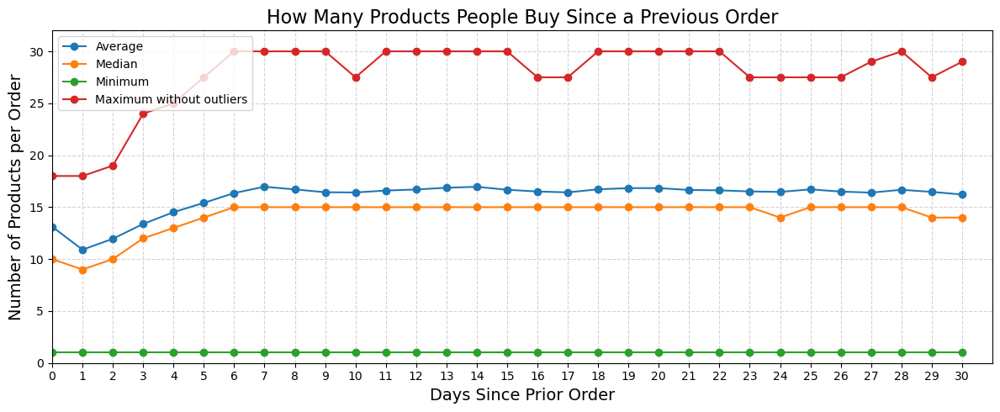

In [151]:
# Plot the data
plt.figure(figsize=(12,5))
plt.plot(avg_products['days_since_prior_order'], avg_products['num_products'], marker='o', label='Average')
plt.plot(median_products['days_since_prior_order'], median_products['num_products'], marker='o', label='Median')
plt.plot(min_products['days_since_prior_order'], min_products['num_products'], marker='o', label='Minimum')
plt.plot(upper_whisker.index, upper_whisker.values, marker='o', label='Maximum without outliers')
plt.xlabel('Days Since Prior Order', fontsize=14)
plt.ylabel('Number of Products per Order', fontsize=14)
plt.title('How Many Products People Buy Since a Previous Order', fontsize=16)
plt.xlim([0, avg_products['days_since_prior_order'].max()+1])
plt.ylim([0, upper_whisker.values.max()+2])
plt.xticks(np.arange(0, avg_products['days_since_prior_order'].max()+1, step=1))
plt.grid(True, color='lightgrey', linestyle='--')
plt.tight_layout()
plt.legend(loc='best')

plt.show()

Typically, when people order:
* They purchase a **minimum** of 1 product, irrespective of the number of days since their previous order.
* For **initial orders**, people typically purchase an average of 10 products and 17 at most.
* **During the first 6 days** following a previous order:
    * they buy between 17 to 27 products at most,
    * the average number of products bought ranges from 9 to 14 per order.
* If there is a gap of **7 days or longer** since the last order:
    * they purchase between 27 to 30 products at most,
    * the average number of products per order rises to 15.

### What are the best selling items?

In [19]:
products_count = orders_products_df.groupby('product_id').agg({'product_name': pd.Series.count})
products_count.rename(columns={'product_name':'product_count'}, inplace=True)

products_sold = pd.merge(products_count, df_products, on='product_id')
products_ranged = products_sold.sort_values('product_count', ascending=False)
top_products = products_ranged[:25]
top_products = top_products.sort_values('product_count', ascending=True)

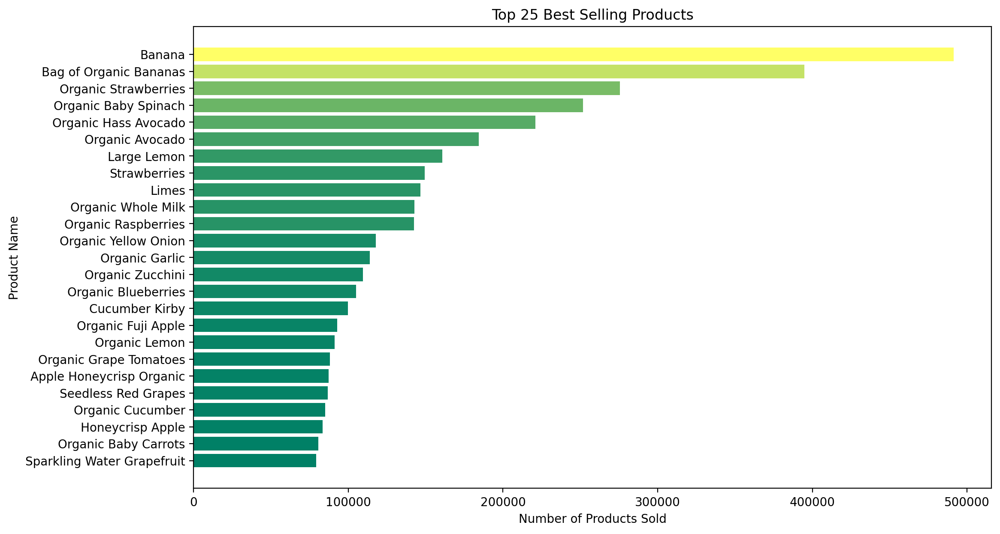

In [20]:
plt.figure(figsize=(12,7), dpi=200)

# Normalize the data and apply colormap
norm = plt.Normalize(min(top_products.product_count), max(top_products.product_count))
colors = cm.summer(norm(top_products.product_count))

plt.barh(top_products.product_name,
         top_products.product_count,
         color=colors)

plt.title('Top 25 Best Selling Products')
plt.ylabel('Product Name')
plt.xlabel('Number of Products Sold')

plt.show()

All the top-selling products are fresh fruit, vegetables and organic whole milk. This shows that users care about their health.
* **Banana** stands out as the top-selling product on the platform.
* Following closely are **strawberries, avocado, spinach, and lemon**.

It's surprising that bread and more dairy products aren't among the top products, especially given that bananas, avocado, and spinach are the bestsellers. This could perhaps be influenced by advertising banners on the platform or recommendations promoting these products.

### What items are most frequently re-ordered?

In [21]:
reordered_prods = orders_products_df.groupby('product_name').agg({'reordered': pd.Series.sum})
reordered_prods = reordered_prods[reordered_prods.reordered > 0].sort_values('reordered', ascending=False)
reordered_prods[:3]

,reordered
product_name,
Banana,415166
Bag of Organic Bananas,329275
Organic Strawberries,214448


In [22]:
top_reordered = reordered_prods[:25]
top_reordered = top_reordered.sort_values('reordered', ascending=True)

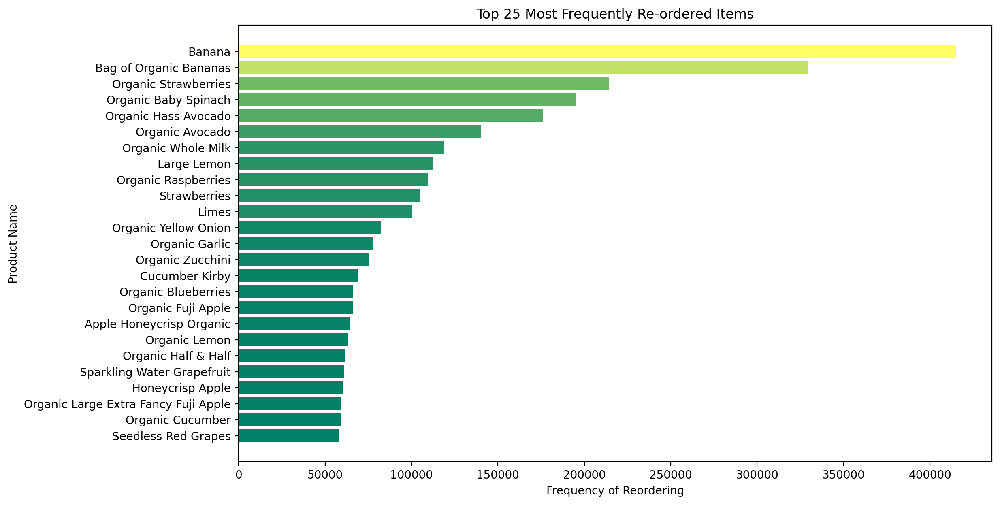

In [23]:
plt.figure(figsize=(12,7), dpi=200)

# Normalize the data and apply colormap
norm = plt.Normalize(min(top_reordered.reordered), max(top_reordered.reordered))
colors = cm.summer(norm(top_reordered.reordered))

plt.barh(top_reordered.index,
         top_reordered.reordered,
         color=colors)

plt.title('Top 25 Most Frequently Re-ordered Items')
plt.ylabel('Product Name')
plt.xlabel('Frequency of Reordering')

plt.show()

The list of the most frequently re-ordered items **aligns closely with the bestsellers list**.
* Bananas again top the chart.
* Followed closely by strawberries, avocado, and spinach.
* The only distinction is the sequence of these products.

All these products might be considered **staples or essential items for many shoppers**.

Given this information, it's crucial to track the availability of these products. This helps maintain a smooth supply chain and prevents interruptions in the availability of products. Ensuring that these products are consistently in stock is crucial for customer satisfaction.

### Which items are added to a cart first? second? third?

##### Creating DataFrames containing the top 20 products ordered in the first, second and third queue

In [78]:
# Items which are added to the cart firstly
df_ordered_first = orders_products_df[orders_products_df.add_to_cart_order == 1]
order_1 = df_ordered_first.groupby('product_name').agg({'add_to_cart_order': pd.Series.count}).sort_values('add_to_cart_order', ascending=False)
top_order_1 = order_1[:20]
top_order_1 = top_order_1.sort_values('add_to_cart_order', ascending=True)
top_order_1[:3] # check the DataFrame

,add_to_cart_order
product_name,
Raspberries,9320
Organic Reduced Fat 2% Milk,9644
Half & Half,9847


In [79]:
# Items which are added to the cart secondly
df_ordered_second = orders_products_df[orders_products_df.add_to_cart_order == 2]
order_2 = df_ordered_second.groupby('product_name').agg({'add_to_cart_order': pd.Series.count}).sort_values('add_to_cart_order', ascending=False)
top_order_2 = order_2[:20]
top_order_2 = top_order_2.sort_values('add_to_cart_order', ascending=True)
top_order_2[:3] # check the DataFrame

,add_to_cart_order
product_name,
Raspberries,9237
Half & Half,9510
Organic Yellow Onion,9780


In [80]:
# Items which are added to the cart thirdly
df_ordered_third = orders_products_df[orders_products_df.add_to_cart_order == 3]
order_3 = df_ordered_third.groupby('product_name').agg({'add_to_cart_order': pd.Series.count}).sort_values('add_to_cart_order', ascending=False)
top_order_3 = order_3[:20]
top_order_3 = top_order_3.sort_values('add_to_cart_order', ascending=True)
top_order_3[:3] # check the DataFrame

,add_to_cart_order
product_name,
Apple Honeycrisp Organic,8422
Sparkling Water Grapefruit,8615
Honeycrisp Apple,8712


##### Merging these three Data Frames while ensuring no products are lost

In [81]:
# Rename columns to identify the source DataFrame
top_order_1['Firstly'] = top_order_1['add_to_cart_order']
top_order_2['Secondly'] = top_order_2['add_to_cart_order']
top_order_3['Thirdly'] = top_order_3['add_to_cart_order']

# Merge the DataFrames using outer join
top_prods_123 = pd.merge(top_order_1, top_order_2, how='outer', on='product_name')
top_prods_123 = pd.merge(top_prods_123, top_order_3, how='outer', on='product_name')

# Fill NaN values with 0
top_prods_123 = top_prods_123.fillna(0)

# Drop the original columns
top_prods_123 = top_prods_123.drop(['add_to_cart_order', 'add_to_cart_order_x', 'add_to_cart_order_y'], axis=1)

In [82]:
# Create a copy of the merged DataFrame and sort it by the total units sold
sorted_top_prods = top_prods_123.copy()
sorted_top_prods['Total'] = sorted_top_prods['Firstly'] + sorted_top_prods['Secondly'] + sorted_top_prods['Thirdly']
sorted_top_prods = sorted_top_prods.sort_values(by='Total', ascending=True)

In [85]:
# Plotting
bar_split = px.bar(sorted_top_prods,
                   x=['Firstly', 'Secondly', 'Thirdly'],
                   y=sorted_top_prods.index,
                   labels={'value': 'Units Sold', 'product_name': 'Product', 'variable': 'Added to cart:'},
                   title='Top 27 Products Added to Cart Initially, Subsequently, and Thirdly',
                   color_discrete_sequence=px.colors.qualitative.T10,
                  )

bar_split.update_layout(yaxis_tickfont=dict(size=10),
                        title_font=dict(size=16),
                       )
bar_split.show()

The sequence of product additions shed light on how customers typically navigate the store.

There are main 3 tiers of products based on the chart above:

* **Tier 1: Hero products**
    * These products will be bought with a high level of likelyhood. They are ordered firstly, secondly and thirdly. Maybe they are even in most orders placed on the platform.
    * Bananas, strawberries, avocado, spinach, whole milk, raspberies, lemon, limes.
* **Tier 2:**
    * These products are added secondly and thirdly and still have relatively big number of orders.
    * Fuji apples, cucumber kirbi, blueberries, yellow onion.
* **Tier 3:**
    * They have similar number of units sold, but less than in previous 2 groups.
    * Soda, reduced fat milk, hass avocados, garlic, honeycrisp apple.

**Conclusions & recommendations:**
* This chart aligns closely with the bestsellers list and the list of the most frequently re-ordered items.
* All these products might be considered as **staples or essential items for many shoppers**.
* Shoppers **start with essentials** and then mostlikely move to discretionary items.
* All these products **might be prioritized** displaying prominently when a user first logs in or visits the site.
* **Bundle deals** can be offered or **recommended related products** to increase the average order value.

### Which aisles are more likely to be reordered from?

In [41]:
# Calculate total purchases
total_aisle = orders_products_df.groupby('aisle')['reordered'].count().reset_index()
total_aisle.rename(columns={'reordered': 'total_purchases'}, inplace=True)

# Calculate purchases with reordered products
reodered_aisle = orders_products_df.groupby('aisle')['reordered'].sum().reset_index()

# Create the DataFrame with 'reordered' and 'total_purchases' columns
merged_aisle = pd.merge(total_aisle, reodered_aisle, on='aisle')
merged_aisle['percent_reorder'] = (merged_aisle.reordered / merged_aisle.total_purchases) * 100
merged_aisle.head()

,aisle,total_purchases,reordered,percent_reorder
0,air fresheners candles,20918,6500,31.07
1,asian foods,173614,60986,35.13
2,baby accessories,8466,4669,55.15
3,baby bath body care,8909,2626,29.48
4,baby food formula,395654,233042,58.90


In [42]:
df_deps = orders_products_df[['aisle', 'department']].drop_duplicates()

# Merge the DataFrames using a left merge
dept_aisle_df = merged_aisle.merge(df_deps[['aisle', 'department']], on='aisle', how='left')
dept_aisle_df.head()

,aisle,total_purchases,reordered,percent_reorder,department
0,air fresheners candles,20918,6500,31.07,household
1,asian foods,173614,60986,35.13,international
2,baby accessories,8466,4669,55.15,babies
3,baby bath body care,8909,2626,29.48,babies
4,baby food formula,395654,233042,58.90,babies


In [43]:
# Determine a threshold: the 90th percentil
threshold = dept_aisle_df['total_purchases'].quantile(0.90)

# Create a new column for display text
dept_aisle_df['text_display'] = dept_aisle_df.apply(lambda row: row['aisle'] if row['total_purchases'] > threshold else '', axis=1)

fig = px.scatter(dept_aisle_df,
                 x='total_purchases',
                 y='percent_reorder',
                 size='total_purchases',
                 color='department',
                 color_discrete_sequence=px.colors.qualitative.T10,
                 text='text_display',
                 hover_name='aisle',
                )

fig.update_traces(textposition='top center')
fig.update_xaxes(title_text='Number of Purchases', range=[0, 4000000],)
fig.update_yaxes(title_text='Percent Reordered Purchases')
fig.update_layout(title='Reordered Purchases by Aisle', title_font=dict(size=20))
fig.show()

Fresh fruits ...

### How often are products from the department/aisle sold?

In [30]:
products_with_dept = pd.merge(products_sold, df_departments, on='department_id')
depts_ranged = products_with_dept.groupby('department').agg({'product_count': pd.Series.sum}).sort_values('product_count',
                                                                                                          ascending=False)
depts_ranged[:3]

,product_count
department,
produce,9888378
dairy eggs,5631067
snacks,3006412


In [31]:
donut = px.pie(depts_ranged,
               names=depts_ranged.index,
               values='product_count',
               title='Orders by Department',
               hole=0.5,
               color_discrete_sequence=px.colors.qualitative.T10,
              )

donut.show()

Based on the department's share of the total number of orders, we can categorize them into four distinct groups:

**Group 1 - Top departments (~46%)**
* The largest department, comprising nearly 30% of all orders, is the produce department, which includes aisles such as fresh fruits and vegetables.
* The second most significant department, dairy eggs, is approximately half the size of the #1 department.
* Both produce and dairy eggs are top-priority departments on the platform.  Products from these departments are the best sellers, are frequently reordered and added to cart initially, subsequently, and thirdly.

**Group 2 - Important departments (~30%)**
* Snacks, beverages, frozen and pantry goods each account for a similar percentage of orders, ranging from 5% to 10% of all orders.

These two groups of departments generate **76%** of all sales on the platform and should be in the **primary focus** of further investigation.

**Group 3 - Small departments (~20%)**
* The following departments fall into this category, representing between 2% and 5% of orders each: bakery, canned goods, deli, dry goods, pasta, household, meat seafood and breakfast. Although smaller in scale, these departments may still hold significance for our users.

**Group 4 - Other (~4%)**
* The remaining departments, such as personal care, baby products, international items, alcohol, and pet supplies, each contribute to less than 1.5% of total sales. Given their minimal impact on overall sales, this group is not a primary focus for further research.

In [32]:
prod_aisle_dept = pd.merge(products_with_dept, df_aisles, on='aisle_id')
prod_aisle_dept[:3] # check the DataFrame

,product_id,product_count,product_name,aisle_id,department_id,department,aisle
0,1,1928,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes
1,78,12,Nutter Butter Cookie Bites Go-Pak,61,19,snacks,cookies cakes
2,102,190,Danish Butter Cookies,61,19,snacks,cookies cakes


In [33]:
fig = px.treemap(prod_aisle_dept, path=['department', 'aisle', 'product_name'], values='product_count',
                 color_discrete_sequence=px.colors.qualitative.T10,
                )

fig.update_layout(title='Interactive Tree Map: Department -> Aisle -> Product')

fig.show()

In [34]:
aisle_counts = prod_aisle_dept.groupby('aisle')['product_count'].sum().reset_index()
aisle_counts.head()

,aisle,product_count
0,air fresheners candles,20918
1,asian foods,173614
2,baby accessories,8466
3,baby bath body care,8909
4,baby food formula,395654


In [35]:
# Determine the department for each aisle
aisle_department = prod_aisle_dept.groupby('aisle')['department'].agg(pd.Series.mode).reset_index()

In [36]:
# Merge the two DataFrames
aisle_dept = pd.merge(aisle_counts, aisle_department, on='aisle').sort_values(by='product_count', ascending=False)
aisle_dept.head()

,aisle,product_count,department
50,fresh fruits,3792661,produce
53,fresh vegetables,3568630,produce
98,packaged vegetables fruits,1843806,produce
133,yogurt,1507583,dairy eggs
93,packaged cheese,1021462,dairy eggs


In [37]:
# Find the top aisles
top_aisles = aisle_dept.nlargest(25, 'product_count')['aisle'].tolist()

# Create a new column that either has the aisle name or 'other_aisles'
aisle_dept['aisle_grouped'] = aisle_dept['aisle'].apply(lambda x: x if x in top_aisles else 'other aisles')

In [38]:
top_aisles = aisle_dept.nlargest(25, 'product_count')

In [39]:
fig = px.bar(top_aisles,
             x='product_count',
             y='aisle',
             color='department', 
             color_discrete_sequence=px.colors.qualitative.T10,
             orientation='h',
             title="Top 25 Aisles",
            )

fig.update_layout(yaxis=dict(tickfont=dict(size=9)))

fig.update_layout(
    title_font=dict(size=20),
    xaxis_title="Products Ordered",
    yaxis_title="Aisle",
    yaxis_categoryorder='total ascending',
    xaxis=dict(titlefont=dict(size=14)),
    yaxis=dict(titlefont=dict(size=14)),
)

fig.show()

Top aisles ...

## When during the day popular products are ordered?

### Orders by department during the day

In [45]:
depts_list = merged_df.groupby('department').size().index
depts_list

Index(['alcohol', 'babies', 'bakery', 'beverages', 'breakfast', 'bulk',
       'canned goods', 'dairy eggs', 'deli', 'dry goods pasta', 'frozen',
       'household', 'international', 'meat seafood', 'missing', 'other',
       'pantry', 'personal care', 'pets', 'produce', 'snacks'],
      dtype='object', name='department')

In [46]:
agg_depts_day = (merged_df.groupby(['department', 'order_hour_of_day'])
                 .size()
                 .reset_index(name='hour_sales')
                 .sort_values('order_hour_of_day', ascending=False))
agg_depts_day[:3] # Check a DataFrame

,department,order_hour_of_day,hour_sales
503,snacks,23,34710
431,personal care,23,5576
287,household,23,9028


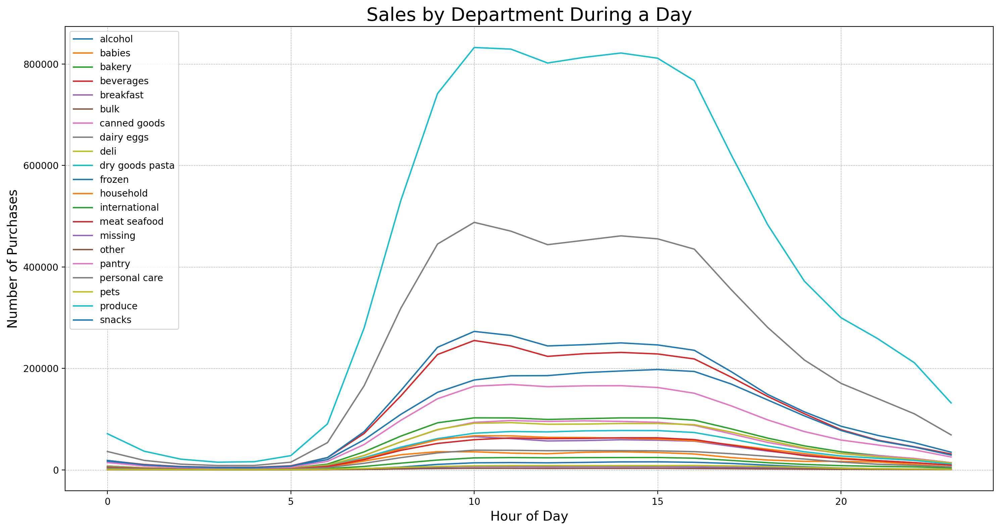

In [47]:
plt.figure(figsize=(15,8), dpi=200)
for dept in depts_list:
    subset = agg_depts_day[agg_depts_day['department'] == dept]
    plt.plot(subset['order_hour_of_day'], subset['hour_sales'], label=dept)

plt.legend(loc="upper left")

plt.title('Sales by Department During a Day', fontsize=20)
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Number of Purchases', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

The trend for 15+ departments is ambiguous; normalisation is needed. Let's attempt to substitute the number of purchases with the percentage of orders (where the total orders for a department in a day equals 100%).

In [48]:
# Calculate total sales per department and percent of orders 
agg_depts_day['total_sales'] = agg_depts_day.groupby('department')['hour_sales'].transform('sum')
agg_depts_day['percent_of_orders'] = (agg_depts_day['hour_sales'] / agg_depts_day['total_sales']) * 100

agg_depts_day[:3] # Check a DataFrame

,department,order_hour_of_day,hour_sales,total_sales,percent_of_orders
503,snacks,23,34710,3006412,1.15
431,personal care,23,5576,468693,1.19
287,household,23,9028,774652,1.17


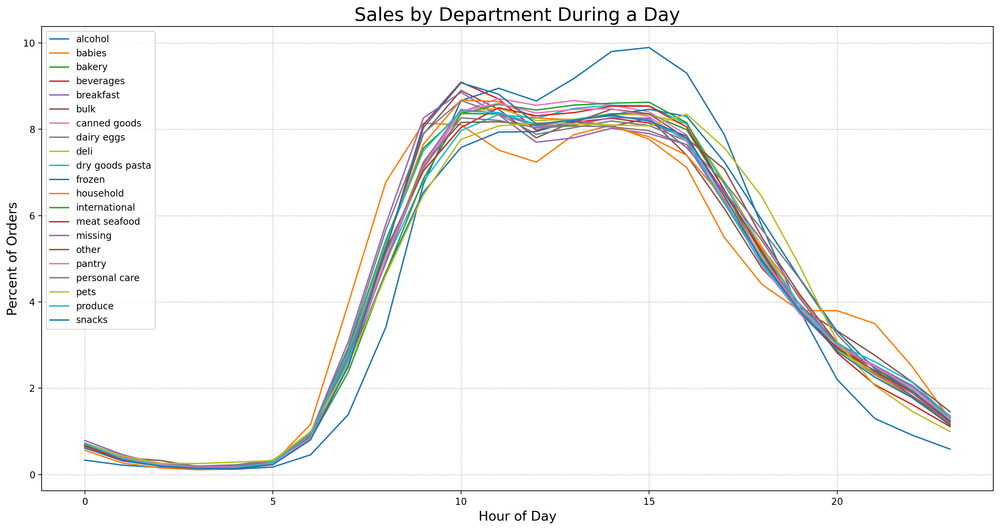

In [49]:
plt.figure(figsize=(15,8), dpi=200)
for dept in depts_list:
    subset = agg_depts_day[agg_depts_day['department'] == dept]
    plt.plot(subset['order_hour_of_day'], subset['percent_of_orders'], label=dept)

plt.legend(loc="upper left")

plt.title('Sales by Department During a Day', fontsize=20)
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Percent of Orders', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

#### 2. Orders by aisle during the day

In [50]:
aisles_list = merged_df.groupby('aisle').size().index
aisles_list

Index(['air fresheners candles', 'asian foods', 'baby accessories',
       'baby bath body care', 'baby food formula', 'bakery desserts',
       'baking ingredients', 'baking supplies decor', 'beauty',
       'beers coolers',
       ...
       'spreads', 'tea', 'tofu meat alternatives', 'tortillas flat bread',
       'trail mix snack mix', 'trash bags liners', 'vitamins supplements',
       'water seltzer sparkling water', 'white wines', 'yogurt'],
      dtype='object', name='aisle', length=134)

In [51]:
agg_aisles_day = (merged_df.groupby(['aisle', 'order_hour_of_day'])
                 .size()
                 .reset_index(name='hour_sales')
                 .sort_values('order_hour_of_day', ascending=False))

# Calculate total sales per aisle and percent of orders 
agg_aisles_day['total_sales'] = agg_aisles_day.groupby('aisle')['hour_sales'].transform('sum')
agg_aisles_day['percent_of_orders'] = (agg_aisles_day['hour_sales'] / agg_aisles_day['total_sales']) * 100

agg_aisles_day.head() # Check the DataFrame

,aisle,order_hour_of_day,hour_sales,total_sales,percent_of_orders
3215,yogurt,23,19461,1507583,1.29
2495,popcorn jerky,23,1789,170441,1.05
2447,pickled goods olives,23,1566,117521,1.33
3143,vitamins supplements,23,611,47028,1.30
3095,trail mix snack mix,23,331,37053,0.89


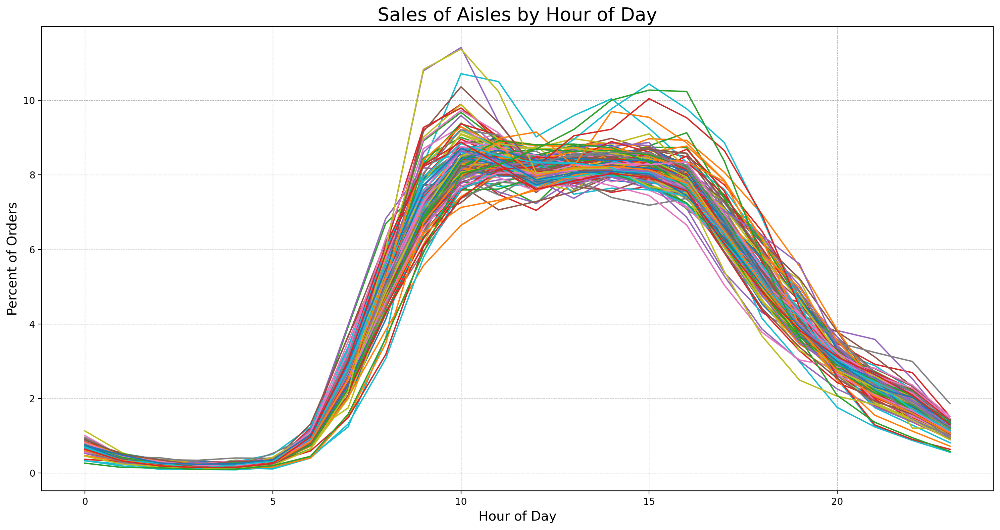

In [52]:
plt.figure(figsize=(15,8), dpi=200)
for aisle in aisles_list:
    subset = agg_aisles_day[agg_aisles_day['aisle'] == aisle]
    plt.plot(subset['order_hour_of_day'], subset['percent_of_orders'], label=aisle)

#plt.legend(loc="upper left")

plt.title('Sales of Aisles by Hour of Day', fontsize=20)
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Percent of Orders', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:623: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



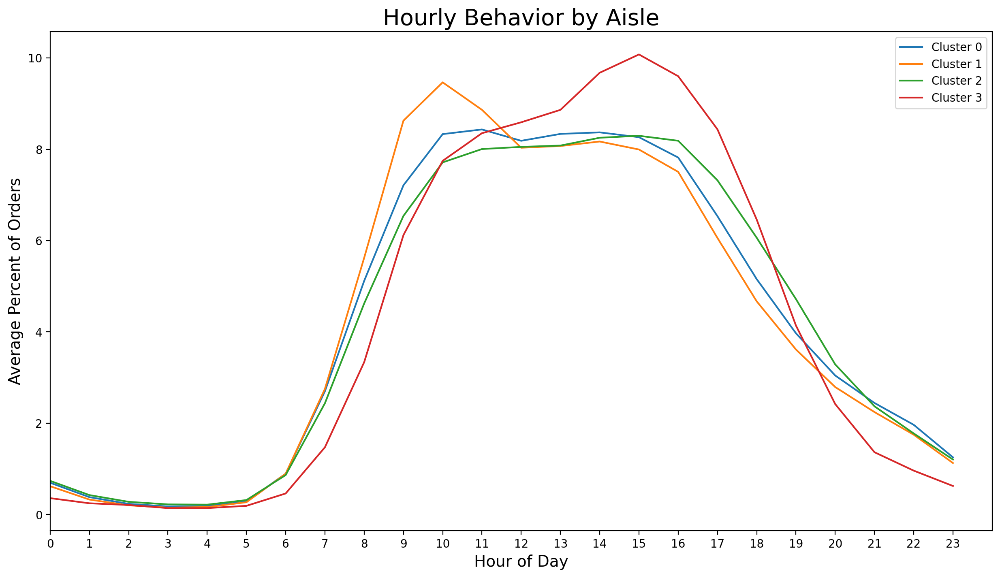

In [53]:
# Prepare data for clustering: Create a pivot table with 'order_hour_of_day' as columns
pivot_df = agg_aisles_day.pivot_table(index='aisle', columns='order_hour_of_day', values='percent_of_orders')

# Clustering aisles based on their hourly patterns
kmeans = KMeans(n_clusters=4, random_state=56)  # Assuming 4 clusters and setting a fixed random seed
clusters = kmeans.fit_predict(pivot_df)

pivot_df['cluster'] = clusters

# Plotting
plt.figure(figsize=(15, 8), dpi=200)

for cluster in pivot_df['cluster'].unique():
    subset = pivot_df[pivot_df['cluster'] == cluster]
    # Calculate the mean percent_of_orders for each hour in this cluster
    mean_percent = subset.mean(axis=0)[:-1]  # Excluding the cluster column from the mean calculation
    plt.plot(mean_percent.index, mean_percent.values, label=f'Cluster {cluster}')

plt.xlim([0, 24])
plt.xticks(np.arange(0, 24, step=1))  # Setting x-axis to show every hour
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Average Percent of Orders', fontsize=14)
plt.title('Hourly Behavior by Aisle', fontsize=20)
plt.legend()
plt.grid(False)
plt.show()

* Aisles in clusters 0 and 2 exhibit contrasting behavior during the morning and afternoon. However, the difference is not dramatically large.
* Products in aisle **cluster 1** tend to be purchased earlier in the day, whereas in **cluster 3** are far more popular when customers are ordering in the evening.

In [54]:
# List the aisles for each cluster:
for cluster in pivot_df['cluster'].unique():
    aisles_in_cluster = pivot_df[pivot_df['cluster'] == cluster].index.tolist()
    print(f"Cluster {cluster} contains the following aisles:")
    for aisle in aisles_in_cluster:
        print(aisle)
    print("\n")

Cluster 0 contains the following aisles:
air fresheners candles
asian foods
baby accessories
baby bath body care
baking ingredients
baking supplies decor
bread
bulk grains rice dried goods
buns rolls
butter
candy chocolate
canned fruit applesauce
canned jarred vegetables
canned meals beans
canned meat seafood
cereal
chips pretzels
condiments
cookies cakes
crackers
diapers wipes
digestion
doughs gelatins bake mixes
dry pasta
eggs
energy sports drinks
feminine care
food storage
fresh dips tapenades
fresh fruits
fresh herbs
fresh vegetables
frozen appetizers sides
frozen breads doughs
frozen breakfast
frozen meat seafood
frozen produce
grains rice dried goods
hot dogs bacon sausage
instant foods
juice nectars
kitchen supplies
kosher foods
latino foods
laundry
lunch meat
marinades meat preparation
meat counter
missing
more household
muscles joints pain relief
oils vinegars
other
other creams cheeses
packaged cheese
packaged meat
packaged poultry
packaged seafood
packaged vegetables fruits


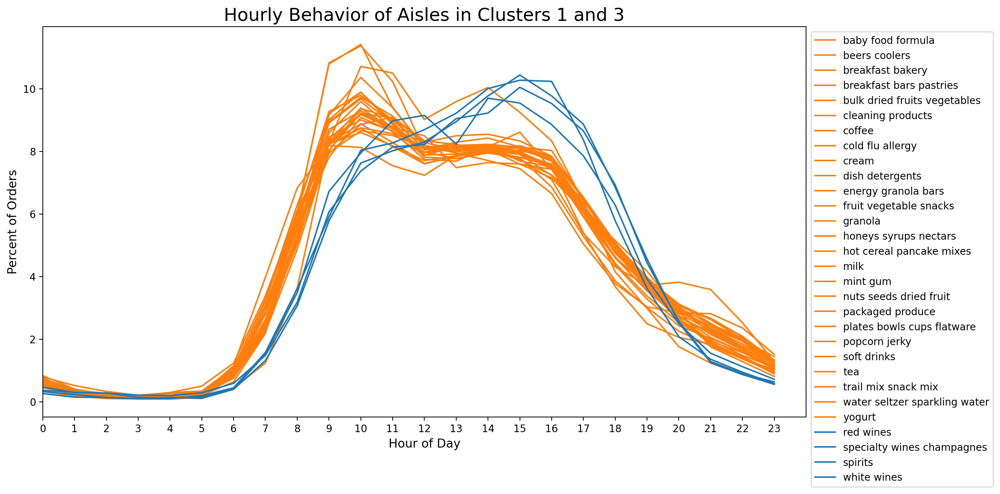

In [55]:
# Define colors for the clusters
color_map = {1: 'tab:orange', 3: 'tab:blue'}

# Plotting
plt.figure(figsize=(14, 7), dpi=200)

# Plotting aisles in clusters 1 and 3
for cluster, color in color_map.items():
    subset = pivot_df[pivot_df['cluster'] == cluster]
    for _, row in subset.iterrows():
        plt.plot(row.index[:-1], row.values[:-1], label=row.name, color=color)

plt.xlim([0, 24])
plt.xticks(np.arange(0, 24, step=1))  # Setting x-axis to show every hour
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('Percent of Orders', fontsize=12)
plt.title('Hourly Behavior of Aisles in Clusters 1 and 3', fontsize=18)
plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)  # Adjust legend location and layout for better visibility
plt.grid(False)
plt.tight_layout()
plt.show()

### Orders by department during the week

In [56]:
agg_depts_week = (merged_df.groupby(['department', 'order_dow'])
                 .size()
                 .reset_index(name='day_sales')
                 .sort_values('order_dow', ascending=False))
agg_depts_week[:3] # Check a DataFrame

,department,order_dow,day_sales
146,snacks,6,370086
20,bakery,6,170560
76,frozen,6,353119


In [57]:
# Calculate total sales per department and percent of orders 
agg_depts_week['total_sales'] = agg_depts_week.groupby('department')['day_sales'].transform('sum')
agg_depts_week['percent_of_orders'] = (agg_depts_week['day_sales'] / agg_depts_week['total_sales']) * 100

agg_depts_week[:3] # Check a DataFrame

,department,order_dow,day_sales,total_sales,percent_of_orders
146,snacks,6,370086,3006412,12.31
20,bakery,6,170560,1225181,13.92
76,frozen,6,353119,2336858,15.11


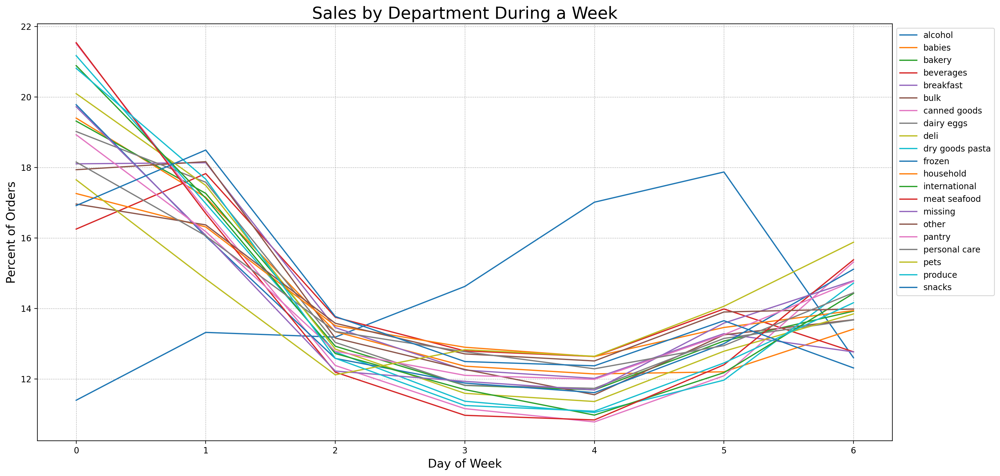

In [58]:
plt.figure(figsize=(15,8), dpi=200)
for dept in depts_list:
    subset = agg_depts_week[agg_depts_week['department'] == dept]
    plt.plot(subset['order_dow'], subset['percent_of_orders'], label=dept)

plt.legend(loc="upper left")

plt.title('Sales by Department During a Week', fontsize=20)
plt.xlabel('Day of Week', fontsize=14)
plt.ylabel('Percent of Orders', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.show()

In [59]:
agg_aisles_week = (merged_df.groupby(['aisle', 'order_dow'])
                 .size()
                 .reset_index(name='day_sales')
                 .sort_values('order_dow', ascending=False))

# Calculate total sales per aisle and percent of orders 
agg_aisles_week['total_sales'] = agg_aisles_week.groupby('aisle')['day_sales'].transform('sum')
agg_aisles_week['percent_of_orders'] = (agg_aisles_week['day_sales'] / agg_aisles_week['total_sales']) * 100

agg_aisles_week.head() # Check the DataFrame

,aisle,order_dow,day_sales,total_sales,percent_of_orders
937,yogurt,6,193653,1507583,12.85
923,water seltzer sparkling water,6,106426,878150,12.12
447,frozen vegan vegetarian,6,16371,104096,15.73
272,dog food care,6,5586,35915,15.55
839,soy lactosefree,6,89510,664493,13.47


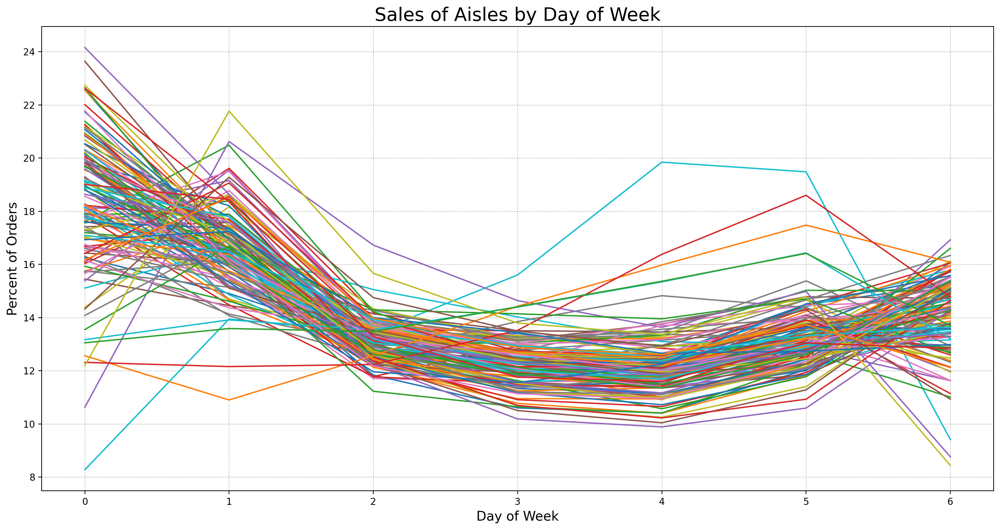

In [60]:
plt.figure(figsize=(15,8), dpi=200)
for aisle in aisles_list:
    subset = agg_aisles_week[agg_aisles_week['aisle'] == aisle]
    plt.plot(subset['order_dow'], subset['percent_of_orders'], label=aisle)

#plt.legend(loc="upper left")

plt.title('Sales of Aisles by Day of Week', fontsize=20)
plt.xlabel('Day of Week', fontsize=14)
plt.ylabel('Percent of Orders', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

/Users/nadyavoynich/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:623: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



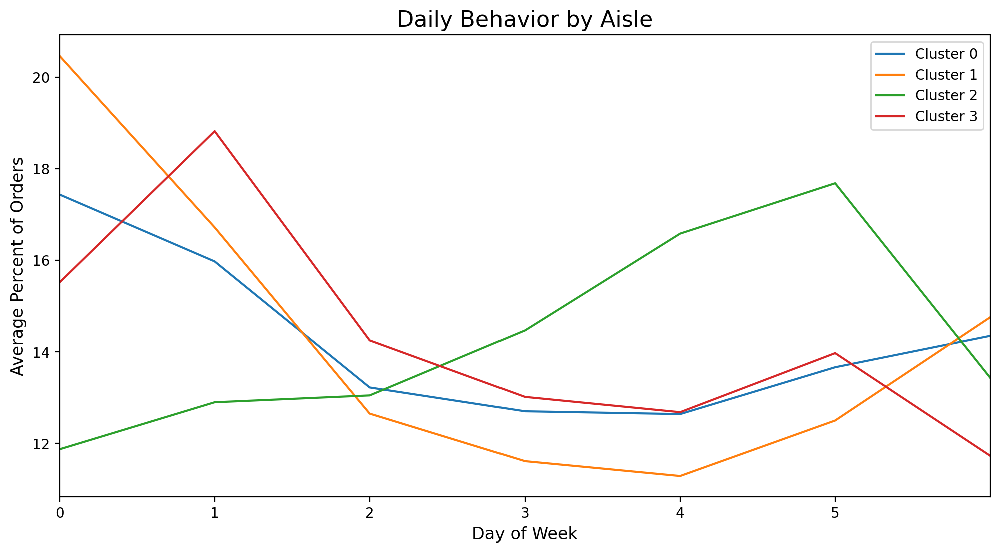

In [61]:
# Prepare data for clustering: Create a pivot table with 'order_hour_of_day' as columns
pivot_df2 = agg_aisles_week.pivot_table(index='aisle', columns='order_dow', values='percent_of_orders')

# Clustering aisles based on their hourly patterns
kmeans = KMeans(n_clusters=4, random_state=56)  # Assuming 4 clusters and setting a fixed random seed
clusters = kmeans.fit_predict(pivot_df2)

pivot_df2['cluster'] = clusters

# Plotting
plt.figure(figsize=(12, 6), dpi=200)

for cluster in pivot_df2['cluster'].unique():
    subset = pivot_df2[pivot_df2['cluster'] == cluster]
    # Calculate the mean percent_of_orders for each hour in this cluster
    mean_percent = subset.mean(axis=0)[:-1]  # Excluding the cluster column from the mean calculation
    plt.plot(mean_percent.index, mean_percent.values, label=f'Cluster {cluster}')

plt.xlim([0, 6])
plt.xticks(np.arange(0, 6, step=1))  # Setting x-axis to show every hour
plt.xlabel('Day of Week', fontsize=12)
plt.ylabel('Average Percent of Orders', fontsize=12)
plt.title('Daily Behavior by Aisle', fontsize=16)
plt.legend()
plt.grid(False)
plt.show()

In [62]:
# List the aisles for each cluster:
for cluster in pivot_df2['cluster'].unique():
    aisles_in_cluster = pivot_df2[pivot_df2['cluster'] == cluster].index.tolist()
    print(f"Cluster {cluster} contains the following aisles:")
    for aisle in aisles_in_cluster:
        print(aisle)
    print("\n")

Cluster 0 contains the following aisles:
air fresheners candles
baby accessories
baby bath body care
bakery desserts
baking ingredients
baking supplies decor
beauty
body lotions soap
butter
cat food care
cereal
chips pretzels
cleaning products
cocoa drink mixes
condiments
crackers
diapers wipes
digestion
dish detergents
dog food care
doughs gelatins bake mixes
energy sports drinks
eye ear care
feminine care
first aid
food storage
frozen dessert
frozen juice
honeys syrups nectars
ice cream ice
ice cream toppings
juice nectars
kitchen supplies
kosher foods
laundry
milk
more household
muscles joints pain relief
oral hygiene
other
packaged seafood
paper goods
refrigerated
refrigerated pudding desserts
soap
specialty cheeses
spreads
trash bags liners
vitamins supplements


Cluster 1 contains the following aisles:
asian foods
baby food formula
bread
bulk grains rice dried goods
buns rolls
canned fruit applesauce
canned jarred vegetables
canned meals beans
canned meat seafood
deodorants
dry p

## IV. Findings & Conclusions

### Closing the database connection to free up resources

In [67]:
#connection.close()